In [1]:
import glob
import os

#get the base dir for vehicle images
dir_vehicles = "./vehicles/"

#add to an array all vehicle file name paths in the above directory
vehicles = []
for dirs in os.listdir(dir_vehicles):
    vehicles.extend(glob.glob(dir_vehicles+dirs+'/*'))
    
#get the base dir for non-vehicle images
dir_nonvehicles = "./non-vehicles/"

#add to an array all non-vehicle file name paths in the above directory
non_vehicles = []
for dirs in os.listdir(dir_nonvehicles):
    non_vehicles.extend(glob.glob(dir_nonvehicles+dirs+'/*'))


In [2]:
import cv2
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import time
from skimage.feature import hog
from sklearn.svm import LinearSVC
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# of vehicle images:  8792
# of non-vehicle images:  8968


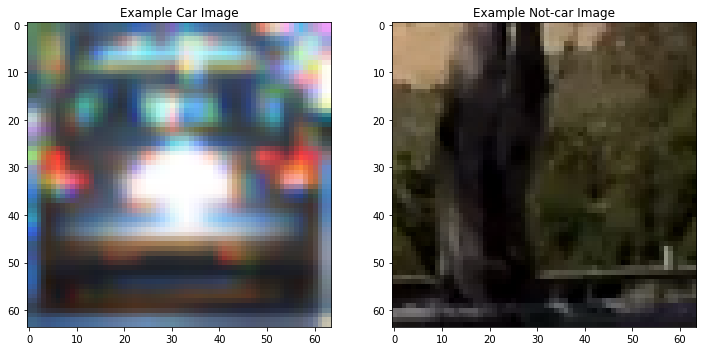

In [3]:
%matplotlib inline
print("# of vehicle images: ", len(vehicles))
print("# of non-vehicle images: ", len(non_vehicles))

# Just for fun choose random car / not-car indices and plot example images   
car_ind = np.random.randint(0, len(vehicles))
notcar_ind = np.random.randint(0, len(non_vehicles))
    
# Read in car / not-car images
car_image = mpimg.imread(vehicles[car_ind])
notcar_image = mpimg.imread(non_vehicles[notcar_ind])

# Plot the examples
fig = plt.figure(figsize=(12,20))
plt.subplot(121)
plt.imshow(car_image)
plt.title('Example Car Image')
plt.subplot(122)
plt.imshow(notcar_image)
plt.title('Example Not-car Image')

In [4]:
test = False

In [5]:
# Define a function to return HOG features and visualization
def get_hog_features(img, orient, pix_per_cell, cell_per_block, vis=False, feature_vec=True):
    if vis == True:
        features, hog_image = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                                  cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=False, 
                                  visualise=True, feature_vector=False)
        return features, hog_image
    else:      
        features = hog(img, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), transform_sqrt=False, 
                       visualise=False, feature_vector=feature_vec)
        return features

if test == True:
    # Define HOG parameters
    orient = 9
    pix_per_cell = 8
    cell_per_block = 2
    gray = cv2.cvtColor(car_image, cv2.COLOR_RGB2GRAY)
    gray_noncar = cv2.cvtColor(notcar_image, cv2.COLOR_RGB2GRAY)
    # Call our function with vis=True to see an image output
    hog_features, hog_image = get_hog_features(gray, orient, 
                            pix_per_cell, cell_per_block, 
                            vis=True, feature_vec=False)
    hog_noncar_features, hog_noncar_image = get_hog_features(gray_noncar, orient, 
                            pix_per_cell, cell_per_block, 
                            vis=True, feature_vec=False)
    # Plot the examples
    fig = plt.figure(figsize=(12,30))
    plt.subplot(121)
    plt.imshow(gray, cmap='gray')
    plt.title('Example Car Image')
    plt.subplot(122)
    plt.imshow(hog_image, cmap='gray')
    plt.title('HOG Visualization')
    fig2 = plt.figure(figsize=(12,30))
    plt.subplot(121)
    plt.imshow(gray_noncar, cmap='gray')
    plt.title('Example Non Car Image')
    plt.subplot(122)
    plt.imshow(hog_noncar_image, cmap='gray')
    plt.title('HOG Non carVisualization')


In [6]:
# Define a function to compute color histogram features  
def color_hist(img, nbins=32): #bins_range=(0, 1)):
    # Compute the histogram of the RGB channels separately
    color1 = np.histogram(img[:,:,0], bins=nbins)
    color2 = np.histogram(img[:,:,1], bins=nbins)
    color3 = np.histogram(img[:,:,2], bins=nbins)
    # Concatenate the histograms into a single feature vector
    hist_features = np.concatenate((color1[0], color2[0], color3[0]))
    # Generating bin centers
    bin_edges = color1[1]
    bin_centers = (bin_edges[1:]  + bin_edges[0:len(bin_edges)-1])/2
    if test:
        # Return the individual histograms, bin_centers and feature vector
        return color1, color2, color3, bin_centers, hist_features
    else:
        return hist_features
    
if test == True:
    c1, c2, c3, bincen, feature_vec = color_hist(car_image, nbins=32)
    plt.imshow(car_image)
    # Plot a figure with all three bar charts
    if c1 is not None:
        fig = plt.figure(figsize=(12,3))
        plt.subplot(131)
        plt.bar(bincen, c1[0])
        plt.xlim(0, 1)
        plt.title('c1 Histogram')
        plt.subplot(132)
        plt.bar(bincen, c2[0])
        plt.xlim(0, 1)
        plt.title('c2 Histogram')
        plt.subplot(133)
        plt.bar(bincen, c3[0])
        plt.xlim(0, 1)
        plt.title('c3 Histogram')
        fig.tight_layout()
    else:
        print('Your function is returning None for at least one variable...')

In [7]:
# Define a function to compute binned color features  
def bin_spatial(img, size=(32, 32)):
    # Convert image to new color space (if specified)
    color1 = cv2.resize(img[:,:,0], size).ravel()
    color2 = cv2.resize(img[:,:,1], size).ravel()
    color3 = cv2.resize(img[:,:,2], size).ravel()
    spatial_features = np.hstack((color1, color2, color3))
    return spatial_features

if test == True:
    feature_vec = bin_spatial(car_image, size=(32, 32))
    # Plot features
    fig = plt.figure(figsize=(12,3))
    plt.subplot(131)
    plt.imshow(car_image)
    plt.title('image')
    plt.subplot(132)
    plt.plot(feature_vec)
    plt.title('Spatially Binned Features')

In [8]:
%matplotlib inline
# Define a function to extract features from a list of images
# Have this function call bin_spatial() and color_hist()
def single_img_features(image, cspace='RGB', spatial_size=(32, 32),
                        hist_bins=32, orient=9, pix_per_cell=8, 
                     cell_per_block=2, hog_channel=0, 
                     spatial_feat=True, hist_feat=True, hog_feat=True, vis=False):
    img_features = [] 
    
    # apply color conversion if other than 'RGB'
    if cspace != 'RGB':
        if cspace == 'HSV':
            feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
        elif cspace == 'LUV':
            feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
        elif cspace == 'HLS':
            feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
        elif cspace == 'YUV':
            feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
        elif cspace == 'YCrCb':
            feature_image = cv2.cvtColor(image, cv2.COLOR_RGB2YCrCb)
    else: feature_image = np.copy(image)

    if spatial_feat == True:
        # Apply bin_spatial() to get spatial color features
        spatial_features = bin_spatial(feature_image, size=spatial_size)
        img_features.append(spatial_features)
    if hist_feat == True:
        # Apply color_hist() also with a color space option now
        hist_features = color_hist(feature_image, nbins=hist_bins)
        img_features.append(hist_features)
    if hog_feat == True:
        # Apply get_hog_features() with vis=False and feature_vec=true
        if hog_channel == 'ALL':
            hog_features = []
            for channel in range(feature_image.shape[2]):
                hog_features.append(get_hog_features(feature_image[:,:,channel], orient, 
                                 pix_per_cell, cell_per_block, 
                                 vis=False, feature_vec=True))
            hog_features = np.ravel(hog_features)
        else:
            hog_features = get_hog_features(feature_image[:,:,hog_channel], 
                                                 orient, pix_per_cell, cell_per_block, 
                                                 vis=False, feature_vec=True)
        
        img_features.append(hog_features)
        
    #return this single image features
    return np.concatenate(img_features)

                     
# Define a function to extract features from a list of images
# Have this function call bin_spatial(), color_hist() and get_hog_features()
def extract_features(imgs, cspace='RGB', spatial_size=(32, 32),
                        hist_bins=32, orient=9, pix_per_cell=8, 
                     cell_per_block=2, hog_channel=0, 
                     spatial_feat=True, hist_feat=True, hog_feat=True
                    ):
    # Create a list to append feature vectors to
    features = []
    # Iterate through the list of images
    for file in imgs:
        # Read in each one by one
        image = mpimg.imread(file)
        img_features = (single_img_features(image, cspace, spatial_size, hist_bins, 
                                           orient, pix_per_cell, cell_per_block, 
                                          hog_channel, spatial_feat, hist_feat, hog_feat, False))
                
        features.append(img_features)

    # Return list of feature vectors
    return features

In [9]:
# Define a function that takes an image,
# start and stop positions in both x and y, 
# window size (x and y dimensions),  
# and overlap fraction (for both x and y)
def slide_window(img, x_start_stop=[None, None], y_start_stop=[None, None], 
                    xy_window=(64, 64), xy_overlap=(0.5, 0.5)):
    # If x and/or y start/stop positions not defined, set to image size
    if x_start_stop[0] == None:
        x_start_stop[0] = 0
    if x_start_stop[1] == None:
        x_start_stop[1] = img.shape[1]
    if y_start_stop[0] == None:
        y_start_stop[0] = 0
    if y_start_stop[1] == None:
        y_start_stop[1] = img.shape[0]
    # Compute the span of the region to be searched    
    xspan = x_start_stop[1] - x_start_stop[0]
    yspan = y_start_stop[1] - y_start_stop[0]
    # Compute the number of pixels per step in x/y
    nx_pix_per_step = np.int(xy_window[0]*(1 - xy_overlap[0]))
    ny_pix_per_step = np.int(xy_window[1]*(1 - xy_overlap[1]))
    # Compute the number of windows in x/y
    nx_buffer = np.int(xy_window[0]*(xy_overlap[0]))
    ny_buffer = np.int(xy_window[1]*(xy_overlap[1]))
    nx_windows = np.int((xspan-nx_buffer)/nx_pix_per_step) 
    ny_windows = np.int((yspan-ny_buffer)/ny_pix_per_step) 
    # Initialize a list to append window positions to
    window_list = []
    # Loop through finding x and y window positions
    # Note: you could vectorize this step, but in practice
    # you'll be considering windows one by one with your
    # classifier, so looping makes sense
    for ys in range(ny_windows):
        for xs in range(nx_windows):
            # Calculate window position
            startx = xs*nx_pix_per_step + x_start_stop[0]
            endx = startx + xy_window[0]
            starty = ys*ny_pix_per_step + y_start_stop[0]
            endy = starty + xy_window[1]
            # Append window position to list
            window_list.append(((startx, starty), (endx, endy)))
    # Return the list of windows
    return window_list


In [10]:
# Define a function you will pass an image 
# and the list of windows to be searched (output of slide_windows())
def search_windows(img, windows, clf, scaler, color_space='RGB', 
                    spatial_size=(32, 32), hist_bins=32, 
                    hist_range=(0, 256), orient=9, 
                    pix_per_cell=8, cell_per_block=2, 
                    hog_channel=0, spatial_feat=True, 
                    hist_feat=True, hog_feat=True):

    #1) Create an empty list to receive positive detection windows
    on_windows = []
    #2) Iterate over all windows in the list
    for window in windows:
        #3) Extract the test window from original image
        test_img = cv2.resize(img[window[0][1]:window[1][1], window[0][0]:window[1][0]], (64, 64))      
        #4) Extract features for that window using single_img_features()
        features = single_img_features(test_img, cspace=color_space, 
                            spatial_size=spatial_size, hist_bins=hist_bins, 
                            orient=orient, pix_per_cell=pix_per_cell, 
                            cell_per_block=cell_per_block, 
                            hog_channel=hog_channel, spatial_feat=spatial_feat, 
                            hist_feat=hist_feat, hog_feat=hog_feat)
        #5) Scale extracted features to be fed to classifier
        test_features = scaler.transform(np.array(features).reshape(1, -1))
        #6) Predict using your classifier
        prediction = clf.predict(test_features)
        #7) If positive (prediction == 1) then save the window
        if prediction == 1:
            on_windows.append(window)
    #8) Return windows for positive detections
    return on_windows
    

In [24]:
# Define a function that takes an image, a list of bounding boxes, 
# and optional color tuple and line thickness as inputs
# then draws boxes in that color on the output

def draw_boxes(img, bboxes, color=(0, 255, 0), thick=6):
    # Make a copy of the image
    draw_img = np.copy(img)
    # Iterate through the bounding boxes
    for bbox in bboxes:
        # Draw a rectangle given bbox coordinates
        cv2.rectangle(draw_img, bbox[0], bbox[1], color, thick)
    # Return the image copy with boxes drawn
    return draw_img

def visualize(fig, rows, cols, imgs, titles):
    for i, img in enumerate(imgs):
        plt.subplot(rows, cols, (i+1))
        plt.title(i+1)
        img_dims = len(img.shape)
        if(img_dims < 3):
            plt.imshow(img, cmap='hot')
            plt.title(titles[i])
        else:
            plt.imshow(img)
            plt.title(titles[i])

In [12]:
#define params for various features

cspace='YCrCb' #RGB, HLS, YUV, LUV, HSV, YCrCb
spatial_size=(32, 32)
hist_bins=32
orient=9
pix_per_cell=8
cell_per_block=2
hog_channel='ALL'
spatial_feat=True
hist_feat=True
hog_feat=True

nsamples = 2000
random_idxs = np.random.randint(0, len(vehicles), nsamples)
test_veh = vehicles#np.array(vehicles)[random_idxs]
test_non_veh = non_vehicles#np.array(non_vehicles)[random_idxs]

start_time = time.time()
vehicle_features = extract_features(test_veh, cspace=cspace, spatial_size=spatial_size,
                        hist_bins=hist_bins, orient=orient, pix_per_cell=pix_per_cell, 
                     cell_per_block=cell_per_block, hog_channel=hog_channel, 
                     spatial_feat=spatial_feat, hist_feat=hist_feat, hog_feat=hog_feat)
print(round((time.time()-start_time), 2), "seconds to extract vehicle features...")

start_time = time.time()
non_vehicle_features = extract_features(test_non_veh, cspace=cspace, spatial_size=spatial_size,
                        hist_bins=hist_bins, orient=orient, pix_per_cell=pix_per_cell, 
                     cell_per_block=cell_per_block, hog_channel=hog_channel, 
                     spatial_feat=spatial_feat, hist_feat=hist_feat, hog_feat=hog_feat)
print(round((time.time()-start_time), 2), "seconds to extract non-vehicle features...")

X = np.vstack((vehicle_features, non_vehicle_features)).astype(np.float64)
X_scaler = StandardScaler().fit(X)
X_scaled = X_scaler.transform(X)

#labels
y = np.hstack((np.ones(len(vehicle_features)), np.zeros(len(non_vehicle_features))))

#split data into training and test sets
rand_state = np.random.randint(0, 100)
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.1, 
                                                    random_state=rand_state)
print("Feature vector length: ", len(X_train[0]))

#use a LinearSVC to train
svc = LinearSVC()
start_time = time.time()
svc.fit(X_train, y_train)

print(round((time.time()-start_time), 2), " seconds to train SVC..")
print("Test accuracy of SVC: ", round(svc.score(X_test, y_test), 4))

/Users/puchkoo/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


39.19 seconds to extract vehicle features...
39.52 seconds to extract non-vehicle features...
Feature vector length:  8460
26.21  seconds to train SVC..
Test accuracy of SVC:  0.9921


/Users/puchkoo/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


1.5408148765563965 seconds to process one image searching 351 windows
1.3742868900299072 seconds to process one image searching 351 windows
1.3663790225982666 seconds to process one image searching 351 windows
1.375809907913208 seconds to process one image searching 351 windows
1.3751769065856934 seconds to process one image searching 351 windows
1.3697879314422607 seconds to process one image searching 351 windows


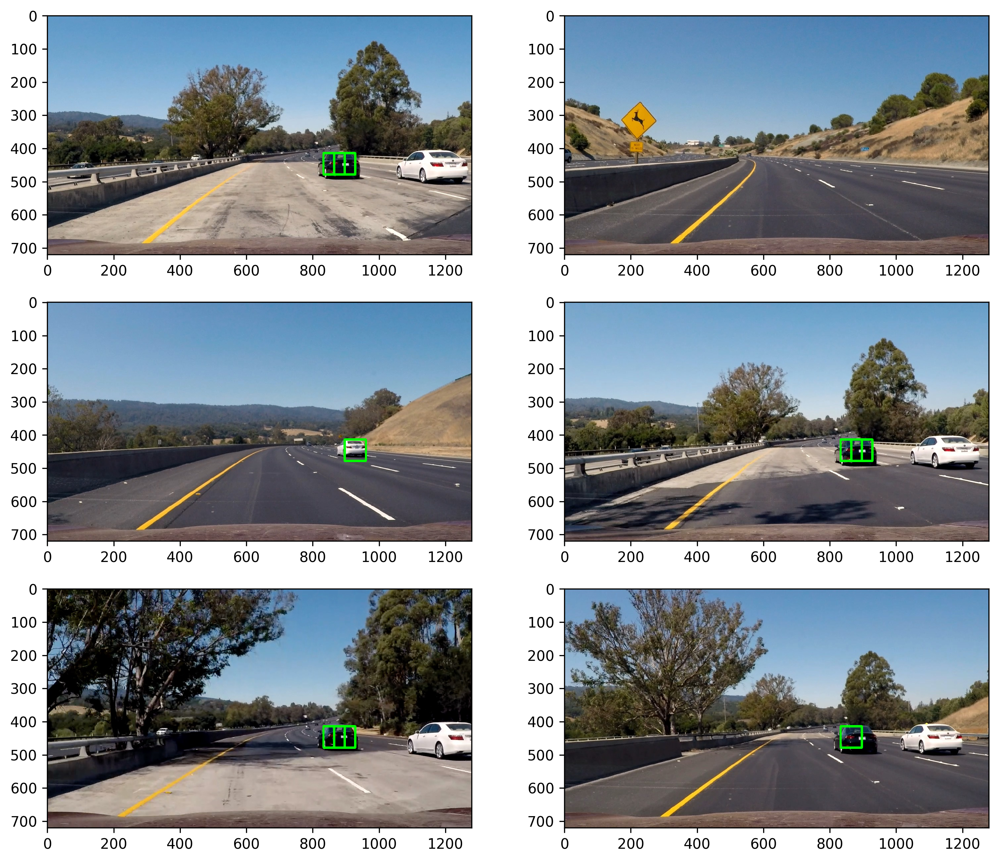

In [13]:
%matplotlib inline
file_path = "./test_images/*"
test_images = glob.glob(file_path)
images = []
titles = []
y_top_bot = [350, 680]
overlap = 0.5

for file in test_images:
    t1 = time.time()
    img = mpimg.imread(file)
    draw_img = np.copy(img)
    img = img.astype(np.float32)/255
    windows = slide_window(img, x_start_stop=[None, None], y_start_stop=y_top_bot, 
                          xy_window=(64,64), xy_overlap=(overlap,overlap))
    hot_windows = search_windows(img, windows, svc, X_scaler, color_space=cspace,
                                spatial_size=spatial_size, hist_bins=hist_bins,
                                orient=orient, pix_per_cell=pix_per_cell, 
                                 cell_per_block=cell_per_block,hog_channel=hog_channel, 
                                 spatial_feat=spatial_feat, hist_feat=hist_feat, hog_feat=hog_feat)
    window_img = draw_boxes(draw_img, hot_windows, color=(0,255,0), thick=5)
    images.append(window_img)
    titles.append('')
    print(time.time()-t1, "seconds to process one image searching", len(windows), "windows")
    
fig = plt.figure(figsize=(12,18), dpi=300)
visualize(fig, 5, 2, images, titles)

In [14]:
def convert_color(img, conv='RGB2YCrCb'):
    if conv == 'RGB2YCrCb':
        return cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb)
    if conv == 'BGR2YCrCb':
        return cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
    if conv == 'RGB2LUV':
        return cv2.cvtColor(img, cv2.COLOR_RGB2LUV)

0.38696908950805664 seconds to process one image
0.37886905670166016 seconds to process one image
0.3798198699951172 seconds to process one image
0.36411595344543457 seconds to process one image
0.3617539405822754 seconds to process one image
0.36813902854919434 seconds to process one image
done


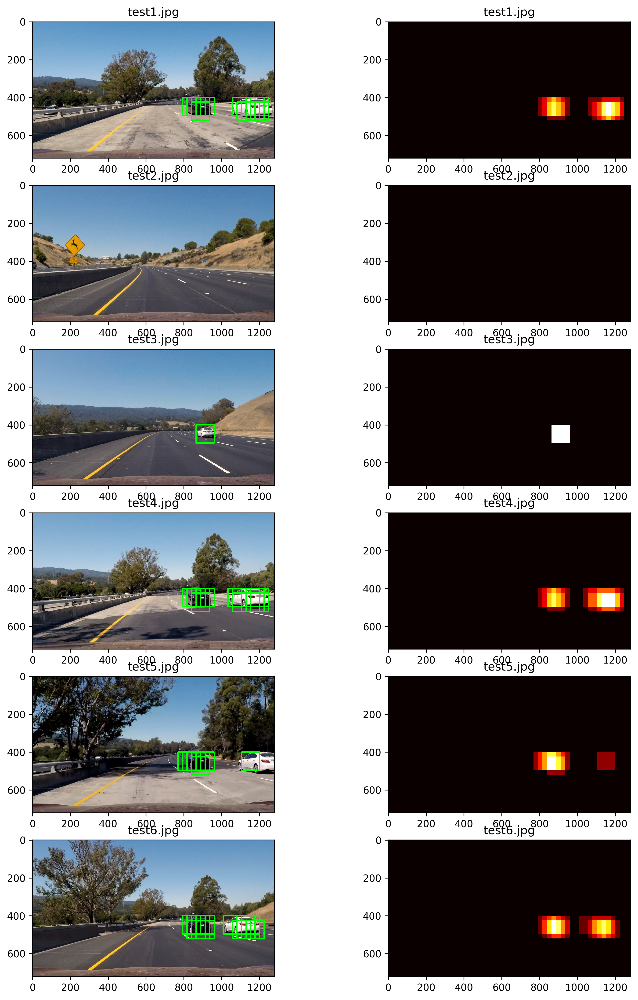

In [35]:
ystart = 400
ystop = 656
# Define a single function that can extract features 
#using hog sub-sampling and make predictions
def find_cars(img,scale):
    
    img = img.astype(np.float32)/255
    
    img_tosearch = img[ystart:ystop,:,:]
    ctrans_tosearch = convert_color(img_tosearch, conv='RGB2YCrCb')
    if scale != 1:
        imshape = ctrans_tosearch.shape
        ctrans_tosearch = cv2.resize(ctrans_tosearch, (np.int(imshape[1]/scale), 
                                                       np.int(imshape[0]/scale)))
        
    ch1 = ctrans_tosearch[:,:,0]
    ch2 = ctrans_tosearch[:,:,1]
    ch3 = ctrans_tosearch[:,:,2]

    # Define blocks and steps as above
    nxblocks = (ch1.shape[1] // pix_per_cell) - cell_per_block + 1
    nyblocks = (ch1.shape[0] // pix_per_cell) - cell_per_block + 1 
    nfeat_per_block = orient*cell_per_block**2
    
    # 64 was the orginal sampling rate, with 8 cells and 8 pix per cell
    window = 64
    nblocks_per_window = (window // pix_per_cell) - cell_per_block + 1
    cells_per_step = 2  # Instead of overlap, define how many cells to step
    nxsteps = (nxblocks - nblocks_per_window) // cells_per_step
    nysteps = (nyblocks - nblocks_per_window) // cells_per_step
    
    # Compute individual channel HOG features for the entire image
    hog1 = get_hog_features(ch1, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog2 = get_hog_features(ch2, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog3 = get_hog_features(ch3, orient, pix_per_cell, cell_per_block, feature_vec=False)
    img_box = (None), (None)
    bboxes = []
    for xb in range(nxsteps):
        for yb in range(nysteps):
            ypos = yb*cells_per_step
            xpos = xb*cells_per_step
            # Extract HOG for this patch
            hog_feat1 = hog1[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_feat2 = hog2[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_feat3 = hog3[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_features = np.hstack((hog_feat1, hog_feat2, hog_feat3))

            xleft = xpos*pix_per_cell
            ytop = ypos*pix_per_cell

            # Extract the image patch
            subimg = cv2.resize(ctrans_tosearch[ytop:ytop+window, xleft:xleft+window], (64,64))
          
            # Get color features
            spatial_features = bin_spatial(subimg, size=spatial_size)
            hist_features = color_hist(subimg, nbins=hist_bins)

            # Scale features and make a prediction
            test_features = X_scaler.transform(np.hstack((spatial_features, 
                                                          hist_features, hog_features)).reshape(1, -1))    
            #test_features = X_scaler.transform(np.hstack((shape_feat, hist_feat)).reshape(1, -1))    
            test_prediction = svc.predict(test_features)
            
            if test_prediction == 1:
                xbox_left = np.int(xleft*scale)
                ytop_draw = np.int(ytop*scale)
                win_draw = np.int(window*scale)
                img_box = (xbox_left, ytop_draw+ystart), (xbox_left+win_draw,ytop_draw+win_draw+ystart)
                bboxes.append(img_box)
                                
    return bboxes


def add_heat(heatmap, bbox_list):
    # Iterate through list of bboxes
    for box in bbox_list:
        # Add += 1 for all pixels inside each bbox
        # Assuming each "box" takes the form ((x1, y1), (x2, y2))
        heatmap[box[0][1]:box[1][1], box[0][0]:box[1][0]] += 1

    # Return updated heatmap
    return heatmap
    
scale = 1.5
images = []
titles = []
for file in test_images:
    t1 = time.time()
    img = mpimg.imread(file)
    draw_img = np.copy(img)
    heat_img = np.zeros_like(img[:,:,0]).astype(np.float)
    bboxes = find_cars(img, scale)
    draw_img = draw_boxes(draw_img, bboxes)
    heat_img = add_heat(heat_img, bboxes)
    images.append(draw_img)
    images.append(heat_img)
    titles.append(file[-9:])
    titles.append(file[-9:])
    print(time.time()-t1, "seconds to process one image")
    
fig = plt.figure(figsize=(12,18), dpi=300)
visualize(fig, 6, 2, images, titles)
print("done")
    
    

1.6466479301452637 seconds to process one image
1.5897340774536133 seconds to process one image
1.5873830318450928 seconds to process one image
1.591588020324707 seconds to process one image
1.596498966217041 seconds to process one image
1.5936050415039062 seconds to process one image
done


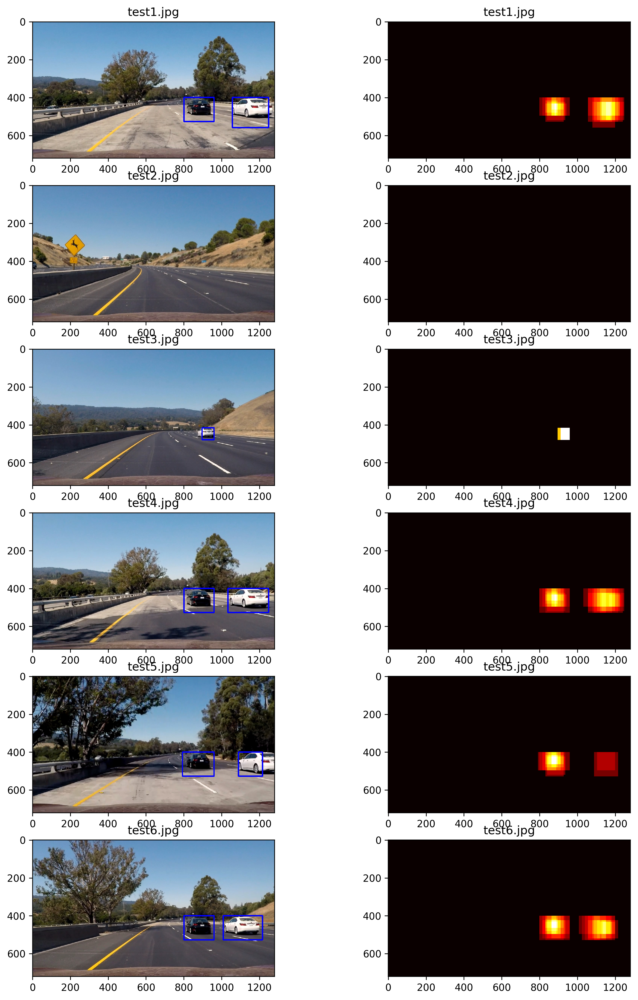

In [40]:
from scipy.ndimage.measurements import label

def apply_threshold(heatmap, threshold):
    # Zero out pixels below the threshold
    heatmap[heatmap <= threshold] = 0
    # Return thresholded map
    return heatmap

def draw_labeled_bboxes(img, labels):
    # Iterate through all detected cars
    for car_number in range(1, labels[1]+1):
        # Find pixels with each car_number label value
        nonzero = (labels[0] == car_number).nonzero()
        # Identify x and y values of those pixels
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Define a bounding box based on min/max x and y
        bbox = ((np.min(nonzerox), np.min(nonzeroy)), (np.max(nonzerox), np.max(nonzeroy)))
        # Draw the box on the image
        cv2.rectangle(img, bbox[0], bbox[1], (0,0,255), 6)
    # Return the image
    return img

images = []
titles = []

for file in test_images:
    t1 = time.time()
    img = mpimg.imread(file)
    scale = 1
    heat_img = np.zeros_like(img[:,:,0]).astype(np.float)
    bboxes = []
    while scale < 3.5:
        bboxes.extend(find_cars(img, scale))
        scale += 0.5
    heat_img = add_heat(heat_img, bboxes)
    heat_img = apply_threshold(heat_img, 1)
    labels = label(heat_img)
    draw_img = draw_labeled_bboxes(np.copy(img), labels)

    images.append(draw_img)
    images.append(heat_img)
    titles.append(file[-9:])
    titles.append(file[-9:])
    print(time.time()-t1, "seconds to process one image")
    
fig = plt.figure(figsize=(12,18), dpi=300)
visualize(fig, 6, 2, images, titles)
print("done")

In [45]:
# Define a class to store data from video
class Vehicle():
    def __init__(self):
        # history of rectangles previous n frames
        self.bboxes = [] 
        
    def add_boxes(self, in_boxes):
        self.bboxes.append(in_boxes)
        if len(self.bboxes) > 15:
            # throw out oldest rectangle set(s)
            self.bboxes = self.bboxes[len(self.bboxes)-15:]

In [51]:
def process_image(img):
    scale = 1
    heat_img = np.zeros_like(img[:,:,0]).astype(np.float)
    bboxes = []
    while scale < 2.5:
        bboxes.extend(find_cars(img, scale))
        scale += 0.5
    #heat_img = add_heat(heat_img, bboxes)
    #heat_img = apply_threshold(heat_img, 1)
    
    # add detections to the history
    if len(bboxes) > 0:
        vehicle_obj.add_boxes(bboxes)
    
    for box in vehicle_obj.bboxes:
        heat_img = add_heat(heat_img, box)
    heat_img = apply_threshold(heat_img, 1 + len(vehicle_obj.bboxes)//2)
    
    labels = label(heat_img)
    draw_img = draw_labeled_bboxes(np.copy(img), labels)
    return draw_img
    

In [53]:
import imageio
imageio.plugins.ffmpeg.download()
from moviepy.editor import VideoFileClip
from IPython.display import HTML

vehicle_obj = Vehicle()
test1 = False
if test1:
    input_video = "test_video.mp4"
    output_video = "test_output_video.mp4"
else:
    input_video = "project_video.mp4"
    output_video = "output_video.mp4"

clip1 = VideoFileClip(input_video)
video_clip = clip1.fl_image(process_image)
%time video_clip.write_videofile(output_video, audio=False)

[MoviePy] >>>> Building video output_video.mp4
[MoviePy] Writing video output_video.mp4


100%|█████████▉| 1260/1261 [30:51<00:01,  1.45s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_video.mp4 

CPU times: user 30min 13s, sys: 48 s, total: 31min 1s
Wall time: 30min 51s
